In [1]:
import IPython.display as ipd

In [2]:
import matplotlib.pyplot as plt

In [1123]:
import jax.numpy as jnp
from jax import vmap, jit, random


In [1124]:
def plot_wave(func):
    plt.plot(vmap(func)(jnp.linspace(0, 1/128, 512)))
    plt.show()

In [1125]:
def plot_audio(func, seconds=1):
    plt.plot(vmap(func)(jnp.linspace(0, seconds, 4096)))
    plt.show()

In [1126]:
def make_samples(total_measures, beat_dur_seconds, beats_per_measure=4.0, measure_offset=0, samples_per_second=196000):
    
    measure_bounds = jnp.array([measure_offset, measure_offset + total_measures])
    seconds_per_measure = beats_per_measure * beat_dur_seconds
    second_bounds = measure_bounds * seconds_per_measure
    total_samps   = total_measures * seconds_per_measure * samples_per_second
    
    samps = jnp.linspace(second_bounds[0], second_bounds[1], int(total_samps), endpoint=False) 
    return samps

In [1127]:
def note_to_freq(n, beat_dur, beat_subdiv=2, anti_click=True, base_freq=32):
    freq = base_freq * 2**(n/12)
    if anti_click:
        # round oscillator freqs to fit perfectly into small note
        # duration and avoid clicking between notes yes pls
        min_dur = beat_dur / beat_subdiv
        period = 1 / freq
        new_period = min_dur / jnp.round(min_dur / period)
        freq = 1 / new_period
    return freq

In [1128]:
def sin_osc(n, beat_dur, t, taper_hi=1024):
    f = note_to_freq(n, beat_dur)
    return jnp.sin(2*jnp.pi*t*f)*(jnp.exp(-f/taper_hi))

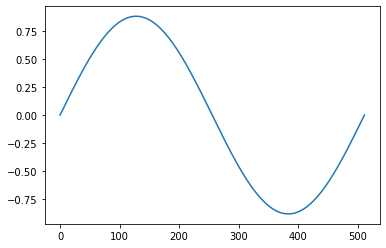

In [1129]:
plot_wave(lambda t: sin_osc(24, 0.5, t))

In [1130]:
def square_osc(n, beat_dur, t, taper_hi=1024):
    f = note_to_freq(n, beat_dur)
    return (-2.0*jnp.floor(f*jnp.mod(t, 1/f)+0.5)+1.0)*(jnp.exp(-f/taper_hi))

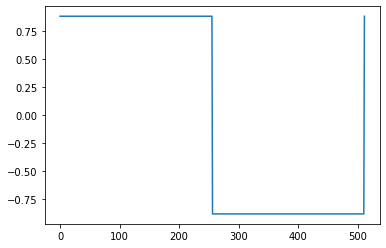

In [1131]:
plot_wave(lambda t: square_osc(24, 0.5, t))

In [1132]:
def soft_square_osc(n, beat_dur, t, k=5, taper_hi=1024):
    f = note_to_freq(n, beat_dur)
    return (2.0*(1.0/(jnp.tan(jnp.pi*t*f-jnp.pi*0.25)**(2*k)+1.0))-1.0) *(jnp.exp(-f/taper_hi))

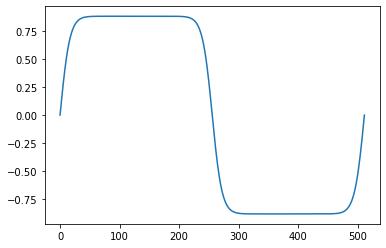

In [1133]:
plot_wave(lambda t: soft_square_osc(24, 0.5, t))

In [1134]:
def tri_osc(n, beat_dur, t, taper_hi=1024):
    f = note_to_freq(n, beat_dur)
    return -4.0*jnp.abs(jnp.modf(f*t+0.25)[0]-0.5)+1.0#*(jnp.exp(-f/taper_hi))

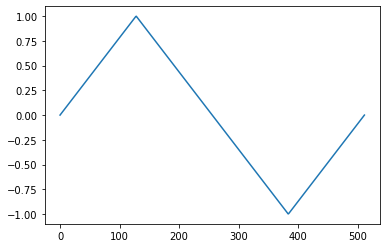

In [1135]:
plot_wave(lambda t: tri_osc(24, 0.5, t))

In [1136]:
def to_scale(n):
    scale = jnp.array([0, 2, 4, 5, 7, 9, 11]).astype(jnp.int32)
    return (n // 7 * 12) + scale[n % 7]

In [1137]:
def chord(root, notes):
    return vmap(to_scale)(root + jnp.array(notes))

In [1138]:
def multi_osc(notes, osc, beat_dur, t):
    return vmap(lambda n: osc(n, beat_dur, t))(notes).mean()

In [1139]:
multi_osc(chord(0, [0, 5, 9]), sin_osc, 0.5, 0.0)

DeviceArray(0., dtype=float32)

In [1140]:
def beat_count(t, subdiv, beat_dur):
    return jnp.floor(subdiv * t / beat_dur).astype(jnp.int32)

In [1141]:
def seq_selector(note_seq, beat_dur):
    return lambda t: jnp.array(note_seq)[jnp.floor(t / beat_dur).astype(jnp.int32) % len(note_seq)]

In [1142]:
[5,76,8][jnp.floor(66.7 / 0.5).astype(jnp.int32) % len([4,65,7])]

76

In [1144]:
def lfo(osc, beat_dur, t):
    return osc(2*jnp.pi*t/beat_dur)

In [1145]:
def pulse_lfo(t, beat_dur):
    return 1-jnp.modf(2.0*t/beat_dur)[0]**0.5

In [1146]:
pulse_lfo(0.6, 0.5)

DeviceArray(0.3675444, dtype=float32, weak_type=True)

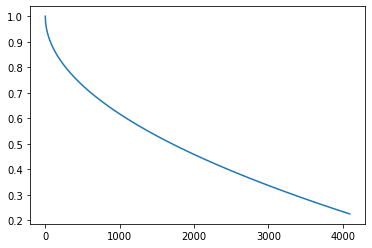

In [1147]:
plot_audio(lambda t: pulse_lfo(t, 0.5), 0.15)

In [1423]:
def noise(t, sample_rate=196000):
    return jnp.sin(jnp.cos(t*21879+jnp.sin(t*342321))*196000.0)

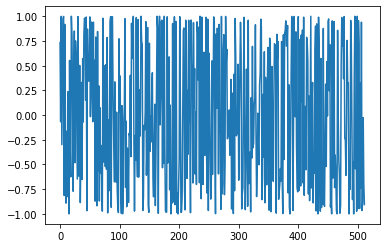

In [1424]:
plot_wave(noise)

In [1425]:
def randy(t, width, size, beat_dur, sample_rate=196000):
    w = width/2
    return jnp.floor(jnp.sin(jnp.floor(size*t/beat_dur)*2179*196000.0)*w+w).astype(jnp.int32)

In [1471]:
def jam(t, beat_dur):
    #return note(24, t)
    #return square_note(-24, t)
    #return jnp.array([note(12.0*i+0, t)/(i+1)**2 for i in range(8)]).sum()/8*note(-60,t)
    #return note(12+to_scale(jnp.floor(4*t).astype(jnp.int32)), beat_dur, t)
    chord_prog = [0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3] + \
                 [0, 0, 0, 0, 2, 2, 2, 2, 3, 3, 3, 3, 3, 2, 1, 2]
    sounds = jnp.array([
        multi_osc(chord(12 + seq_selector(chord_prog, beat_dur)(t), [0, 4, 15, 9]), tri_osc, beat_dur, t), #* pulse_lfo(t, 2.0*beat_dur)#lfo(jnp.sin, 2*beat_dur, t)
        0.25*tri_osc(36+to_scale(randy(t, 12, 2, beat_dur)), beat_dur, t),
        0.15*noise(t) * pulse_lfo(t, 0.5*beat_dur) * lfo(jnp.sin, 4*beat_dur, t)
    ])
    return sounds.mean()#* pulse_lfo(t, 2.0*beat_dur)#lfo(jnp.sin, 2*beat_dur, t)
    #return multi_osc(chord(12+(beat_count(t, 0.25, beat_dur) % 4), [0, 4, 9]), sin_osc, beat_dur, t)

In [1472]:
tri_osc(random.randint(random.PRNGKey(1), (1,), 0, 12), 0.5, 0.6)

DeviceArray([-0.3999939], dtype=float32)

In [1473]:
beat_dur = 0.46
jamb = lambda t : jam(t, beat_dur)

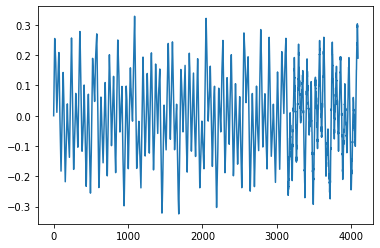

In [1474]:
plot_audio(jamb, 0.15)

In [1475]:
measures = 32
samps = make_samples(measures, beat_dur)

In [1476]:
jam_out = jit(vmap(jamb))(samps)

In [1477]:
#filt = jnp.convolve(jam_out, jnp.sin(jnp.linspace(0, 10, 100)))

In [1478]:
#jnp.sin(jnp.linspace(0, 10, 1000))

In [1479]:
ipd.Audio(jam_out, rate=196000)